# Exploring Access to Food
### IBM Data Science Specialization Final Project
### Emma Wexler

### Part 1: Import Average Income by County from data.census.gov

In [1]:
# The code was removed by Watson Studio for sharing.

,GEO_ID,NAME,K201902_001E,K201902_001M
0,id,Geographic Area Name,Estimate!!Median household income in the past ...,Margin of Error!!Median household income in th...
1,0500000US48001,"Anderson County, Texas",40662,3511
2,0500000US48005,"Angelina County, Texas",45326,5733
3,0500000US48007,"Aransas County, Texas",52215,10174
4,0500000US48013,"Atascosa County, Texas",47807,9312


Clean the data

In [2]:
t_income = t_income.drop([0], axis=0)
t_income.shape

(125, 4)

In [3]:
t_income = t_income.drop('K201902_001M', axis=1)
t_income = t_income.drop('GEO_ID', axis = 1)
t_income.shape

(125, 2)

In [4]:
t_income.columns = [ 'County', 'Median Income']
t_income.head()


,County,Median Income
1,"Anderson County, Texas",40662
2,"Angelina County, Texas",45326
3,"Aransas County, Texas",52215
4,"Atascosa County, Texas",47807
5,"Austin County, Texas",67392


Get Longitude and Latitude for each county and add to data frame

In [5]:

body = client_1337bbf4fdbc4ecda3432d2eead19eb3.get_object(Bucket='default-donotdelete-pr-bxzhcqorhk1wbx',Key='TexasLoc.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )


tx_loc = pd.read_csv(body)
tx_loc.head()

,Latitude,Longitude,County,County Location
0,-97.492799,29.456415,Gonzales,"(-97.492799, 29.456415)"
1,-98.697292,27.043405,Jim Hogg,"(-98.697292, 27.043405)"
2,-97.681378,26.924094,Kenedy,"(-97.681378, 26.924094)"
3,-96.965687,30.310651,Lee,"(-96.965687, 30.310651)"
4,-95.853568,32.211881,Henderson,"(-95.853568, 32.211881)"


In [6]:
tx_loc.columns = ['Longitude', 'Latitude', 'County', 'County Location']
tx_loc.head()

,Longitude,Latitude,County,County Location
0,-97.492799,29.456415,Gonzales,"(-97.492799, 29.456415)"
1,-98.697292,27.043405,Jim Hogg,"(-98.697292, 27.043405)"
2,-97.681378,26.924094,Kenedy,"(-97.681378, 26.924094)"
3,-96.965687,30.310651,Lee,"(-96.965687, 30.310651)"
4,-95.853568,32.211881,Henderson,"(-95.853568, 32.211881)"


In [7]:
tx_loc['County'] = tx_loc['County'] + ' County, Texas'

In [9]:
tx_df = pd.merge(t_income, tx_loc, on='County')

In [11]:
#making sure the dataframes merged properly
print(tx_df.shape)
print(t_income.shape)
print(tx_loc.shape)

(123, 5)
(125, 2)
(254, 4)


In [12]:
tx_df = tx_df.drop('County Location', axis=1)
tx_df.shape

(123, 4)

In [13]:
tx_df['County'] = tx_df['County'].map(lambda x: x.lstrip('+-').rstrip(', Texas'))
tx_df.head()

,County,Median Income,Longitude,Latitude
0,Anderson County,40662,-95.652518,31.813215
1,Angelina County,45326,-94.611742,31.254759
2,Aransas County,52215,-96.992590,28.127096
3,Atascosa County,47807,-98.527413,28.894184
4,Austin County,67392,-96.277918,29.887112


In [14]:
#convert income to a float
tx_df['Median Income'] = tx_df['Median Income'].astype(float)
tx_df.dtypes

County            object
Median Income    float64
Longitude        float64
Latitude         float64
dtype: object

Map the data by income

In [16]:
#Install folium if necessary
#!conda install -c conda-forge folium=0.5.0 --yes #uncomment to install
import folium

print('Folium installed and imported!')

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - folium=0.5.0


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-certificates-2020.6.20  |       hecda079_0         145 KB  conda-forge
    altair-4.1.0               |             py_1         614 KB  conda-forge
    certifi-2020.6.20          |   py36h9f0ad1d_0         151 KB  conda-forge
    folium-0.5.0               |             py_0          45 KB  conda-forge
    python_abi-3.6             |          1_cp36m           4 KB  conda-forge
    vincent-0.4.4              |             py_1          28 KB  conda-forge
    openssl-1.1.1g             |       h516909a_1         2.1 MB  conda-forge
    branca-0.4.1               |             py_0          26 KB  conda-forge
    ------------------------------------------------------------
                       

In [17]:
latitude = 31.9686
longitude = -99.9018


tx_map = folium.Map(location=[latitude, longitude], zoom_start=6)
          

In [18]:
#download county outline
!wget --quiet https://data.cityofdenton.com/dataset/0c4fcbc0-6c9a-4c76-98e2-d29f918e31c6/resource/be1b384f-3b2e-4238-88a8-4410cb36f7fc/download/c8efcc13-b5b4-48b5-9873-933844822d6ctexascounties.geojson -O tx_counties.json
print('done') 

done


In [19]:
tx_geo = r'tx_counties.json' # geojson file

Map income in Texas Counties

In [20]:
#create and run map
tx_map.choropleth(
    geo_data = tx_geo ,
    data=tx_df,
    columns=['County', 'Median Income'],
    key_on='feature.properties.namelsad',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Median Income in Texas'
)
tx_map

### Part 2: Foursquare API
Access data on food and grocery stores in Texas counties from Foursquare

In [21]:
#foursquare credentials
CLIENT_ID = 'PS4AL2XWQS354LAWAY43S2QG4OGR2G12FVPBSPNIC24Z3DYY' # your Foursquare ID
CLIENT_SECRET = 'K05GJZUCUGQS0ULU00ZXYZJL1LJX33XRDMBJWHXYZ2NTM3JU' # your Foursquare Secret
VERSION = '20180604'
LIMIT = 300

In [22]:
import requests # library to handle requests
# tranforming json file into a pandas dataframe library
from pandas.io.json import json_normalize

In [23]:
#coordinates of Austin as an example
latitude = 30.2672
longitude = -97.7431
radius = 5000
categoryId = '4bf58dd8d48988d1f9941735' #id for food and drink store

In [24]:
url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}&categoryId={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, radius, LIMIT, categoryId)

In [25]:
results = requests.get(url).json()

In [26]:
'There are {} around Austin .'.format(len(results['response']['venues']))

'There are 50 around Austin .'

In [27]:
items = results['response']['venues']

{'id': '52ae1d3311d279cc7a2bbb7f',
 'name': 'Royal Blue Grocery',
 'location': {'address': '301 Brazos St Ste 101',
  'crossStreet': '3rd St',
  'lat': 30.264963,
  'lng': -97.742154,
  'labeledLatLngs': [{'label': 'display',
    'lat': 30.264963,
    'lng': -97.742154}],
  'distance': 265,
  'postalCode': '78701',
  'cc': 'US',
  'city': 'Austin',
  'state': 'TX',
  'country': 'United States',
  'formattedAddress': ['301 Brazos St Ste 101 (3rd St)',
   'Austin, TX 78701',
   'United States']},
 'categories': [{'id': '4bf58dd8d48988d118951735',
   'name': 'Grocery Store',
   'pluralName': 'Grocery Stores',
   'shortName': 'Grocery Store',
   'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/shops/food_grocery_',
    'suffix': '.png'},
   'primary': True}],
 'referralId': 'v-1596057659',
 'hasPerk': False}

In [28]:
dataframe = json_normalize(items) # flatten JSON
dataframe.shape

(50, 24)

Define functions to count the number of food stores in a county

In [29]:
#function to get the number of venues in a location
def get_venues(lat, lon):
    latitude = lat
    longitude = lon
    radius = 5000
    categoryId = '4bf58dd8d48988d1f9941735'
    url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&v={}&radius={}&limit={}&categoryId={}'.format(CLIENT_ID, CLIENT_SECRET, latitude, longitude, VERSION, radius, LIMIT, categoryId)
    results = requests.get(url).json()
    if len(results['response']['venues']) > 0:
        return len(results['response']['venues'])
    else:
        return 0

In [30]:
#example austin
get_venues(latitude, longitude)

50

In [33]:
#make the function applicable to a row in a dataframe
def row_count(row):
    lat = row['Latitude']
    lon = row['Longitude']
    return get_venues(lat, lon)


In [35]:
#test the row count function
for i in range(3):
    x = row_count(tx_df.iloc[i])
    print(x)

3
1
2


In [36]:
tx_df['Count'] = tx_df.apply(row_count, axis=1) 
tx_df.head()

,County,Median Income,Longitude,Latitude,Count
0,Anderson County,40662.0,-95.652518,31.813215,3
1,Angelina County,45326.0,-94.611742,31.254759,1
2,Aransas County,52215.0,-96.992590,28.127096,2
3,Atascosa County,47807.0,-98.527413,28.894184,4
4,Austin County,67392.0,-96.277918,29.887112,1


Start to visualize the data

In [38]:
from matplotlib import pyplot

{'whiskers': [<matplotlib.lines.Line2D at 0x7f823dfbb2b0>,
 'caps': [<matplotlib.lines.Line2D at 0x7f823dfbb940>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f823dfbb160>],
 'medians': [<matplotlib.lines.Line2D at 0x7f823dfbbfd0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f823dfc8358>],
 'means': []}

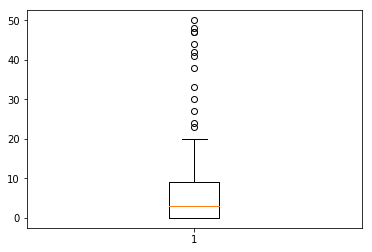

In [40]:
pyplot.boxplot(tx_df['Count'])

In [41]:
print('Mean Count is ' + str(tx_df['Count'].mean()))
print('Max Count is ' + str(tx_df['Count'].max()))
print('Min Count is ' + str(tx_df['Count'].min()))

Mean Count is 7.7317073170731705
Max Count is 50
Min Count is 0


(array([76., 17.,  6.,  8.,  5.,  1.,  2.,  1.,  3.,  4.]),
 array([ 0.,  5., 10., 15., 20., 25., 30., 35., 40., 45., 50.]),
 <a list of 10 Patch objects>)

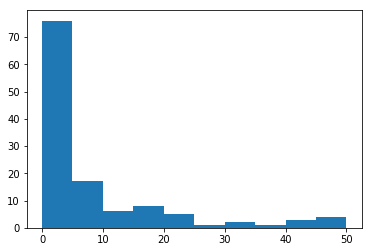

In [42]:
pyplot.hist(tx_df['Count'])

In [43]:
count_map = folium.Map(location=[latitude, longitude], zoom_start=6)

In [136]:
count_map.choropleth(
    geo_data = tx_geo ,
    data=tx_df,
    columns=['County', 'Count'],
    key_on='feature.properties.namelsad',
    fill_color= 'YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Number of Food stores in area Texas'
)
count_map

### Part 3: Model the relationship between income and food access

In [44]:
from sklearn.linear_model import LinearRegression
import numpy as np

This is a linear regression and scatterplot of the data without normalization

In [45]:
x = np.array(tx_df['Median Income']).reshape((-1,1))
y = np.array(tx_df['Count'])

In [46]:
LR = LinearRegression().fit(x,y)

In [47]:
rsq = LR.score(x,y)
rsq

0.0787266813579276

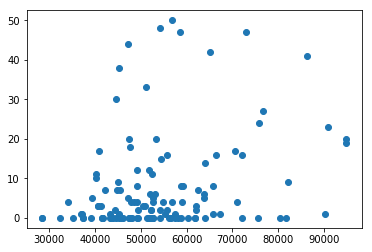

In [77]:
pyplot.scatter(x,y)

Adding population data to try to normalize the counts

In [55]:

body = client_1337bbf4fdbc4ecda3432d2eead19eb3.get_object(Bucket='default-donotdelete-pr-bxzhcqorhk1wbx',Key='TXPOP2.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

tx_pop = pd.read_csv(body)
tx_pop.head()


,GEO_ID,NAME,B01003_001E,B01003_001M
0,id,Geographic Area Name,Estimate!!Total,Margin of Error!!Total
1,0500000US48001,"Anderson County, Texas",57747,*****
2,0500000US48003,"Andrews County, Texas",17577,*****
3,0500000US48005,"Angelina County, Texas",87700,*****
4,0500000US48007,"Aransas County, Texas",24832,*****


In [56]:
tx_pop.columns = ['GEO_ID', 'County', 'Population', "ME"]
tx_pop.head()

,GEO_ID,County,Population,ME
0,id,Geographic Area Name,Estimate!!Total,Margin of Error!!Total
1,0500000US48001,"Anderson County, Texas",57747,*****
2,0500000US48003,"Andrews County, Texas",17577,*****
3,0500000US48005,"Angelina County, Texas",87700,*****
4,0500000US48007,"Aransas County, Texas",24832,*****


In [57]:
tx_pop['County'] = tx_pop['County'].map(lambda x: x.lstrip('+-').rstrip(', Texas'))
tx_pop.head()

,GEO_ID,County,Population,ME
0,id,Geographic Area Nam,Estimate!!Total,Margin of Error!!Total
1,0500000US48001,Anderson County,57747,*****
2,0500000US48003,Andrews County,17577,*****
3,0500000US48005,Angelina County,87700,*****
4,0500000US48007,Aransas County,24832,*****


In [58]:
tx_pop = tx_pop.drop(['GEO_ID', 'ME'], axis=1)
tx_pop.head()

,County,Population
0,Geographic Area Nam,Estimate!!Total
1,Anderson County,57747
2,Andrews County,17577
3,Angelina County,87700
4,Aransas County,24832


In [59]:
tx_pop = tx_pop.drop([0], axis=0)
tx_pop.head()

,County,Population
1,Anderson County,57747
2,Andrews County,17577
3,Angelina County,87700
4,Aransas County,24832
5,Archer County,8793


In [60]:
final_df = pd.merge(tx_df, tx_pop, on='County')
print (final_df.shape)
final_df.head()

(123, 6)


,County,Median Income,Longitude,Latitude,Count,Population
0,Anderson County,40662.0,-95.652518,31.813215,3,57747
1,Angelina County,45326.0,-94.611742,31.254759,1,87700
2,Aransas County,52215.0,-96.992590,28.127096,2,24832
3,Atascosa County,47807.0,-98.527413,28.894184,4,48139
4,Austin County,67392.0,-96.277918,29.887112,1,29292


In [65]:
final_df['Population'] = final_df['Population'].astype(float)
final_df.dtypes

County            object
Median Income    float64
Longitude        float64
Latitude         float64
Count              int64
Population       float64
dtype: object

In [88]:
#normalize the data by dividing counts by population
final_df['div'] = final_df['Count']*100000/final_df['Population']
final_df.head()

,County,Median Income,Longitude,Latitude,Count,Population,div,mult
0,Anderson County,40662.0,-95.652518,31.813215,3,57747.0,5.195075,173241.0
1,Angelina County,45326.0,-94.611742,31.254759,1,87700.0,1.140251,87700.0
2,Aransas County,52215.0,-96.992590,28.127096,2,24832.0,8.054124,49664.0
3,Atascosa County,47807.0,-98.527413,28.894184,4,48139.0,8.309271,192556.0
4,Austin County,67392.0,-96.277918,29.887112,1,29292.0,3.413901,29292.0


{'whiskers': [<matplotlib.lines.Line2D at 0x7f82374846a0>,
 'caps': [<matplotlib.lines.Line2D at 0x7f8237484d30>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f8237484550>],
 'medians': [<matplotlib.lines.Line2D at 0x7f823748c400>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f823748c748>],
 'means': []}

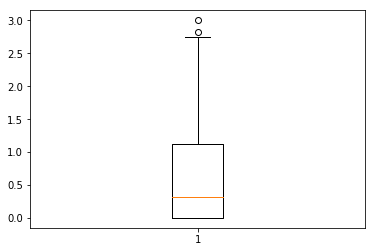

In [82]:
pyplot.boxplot(final_df['div']) 

(array([59., 18.,  8., 11.,  3.,  6.,  7.,  4.,  4.,  3.]),
 array([ 0.        ,  3.00273249,  6.00546497,  9.00819746, 12.01092995,
        15.01366243, 18.01639492, 21.01912741, 24.02185989, 27.02459238,
        30.02732487]),
 <a list of 10 Patch objects>)

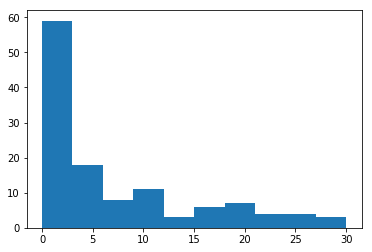

In [89]:
pyplot.hist(final_df['div']) 

In [90]:
x_sc = np.array(final_df['Median Income']).reshape((-1,1))
y_sc = np.array(final_df['div'])

In [91]:
l_sc = LinearRegression().fit(x_sc,y_sc)

In [92]:
l_sc.score(x_sc, y_sc)

0.0006861874474551888

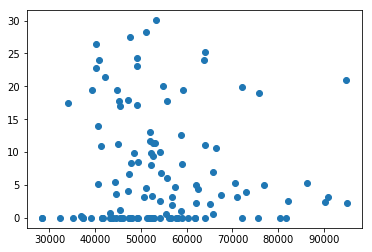

In [93]:
pyplot.scatter(x_sc, y_sc)

It turns out normalizing the data by population does not make much of a difference. Likely, the models are not working because the reports of food and drink stores are not very accurate from FourSquare.